# Pothle and Road Surface Irregularity Detector
**Summary:** <br> 
In this project, I will be biulding a pothole and road surface irregularity detector using deep learning. The data set was from [this](https://www.researchgate.net/publication/279538022_Detecting_Potholes_Using_Simple_Image_Processing_Techniques_and_Real-World_Footage) academic research work where the author employed image processing for a similar task with no reference to machine learning. 
<br>
<br>

**Areas of commercial application:**
>Insurance – to aid objective vehicle insurance premium calculation <br>
>Road network maintenance - government agencies <br> 
>Autonomous vehicle  vision <br>

**Data set:** <br>
The ata set available in this shared google drive [folder.](https://drive.google.com/drive/folders/1vUmCvdW3-2lMrhsMbXdMWeLcEz__Ocuy).It is subdivided into simplex and complex set. I will be using the simplex set as it has more images than the complex set. In addition I will use a portion of the complex set for model testing and inference.
<br>
<br>
**Technique:** <br>
I will be employing Convolutionalry Neural Network and particularly the ResNet34 architecture as implemented in the [Fastai library.](https://docs.fast.ai/vision.image.html) 
<br>
<br>
**Computing:** <br>
I'm using a preemptive VM terninal from Google Compute Platform. I favored CGP not only beacuse it fully supports the Fastai library but to also take advantage of the $300 free credit they offer for new sign ups.
<br>
<br>
**Data access:** I will download the training and test images into my local terminal, then get them zipped and uploaded to the VM terminal's persistent disk.
<br>
<br>
**References:** [Thinkful Data Science Curriculum](https://courses.thinkful.com/data-201v1/lesson/6.6), [Strided Convolutions, Andrew Ng](https://www.youtube.com/watch?v=tQYZaDn_kSg&list=PLkDaE6sCZn6Gl29AoE31iwdVwSG-KnDzF&index=5), [Fastai V3 tutorial trancript](https://medium.com/@hiromi_suenaga/deep-learning-2-part-2-lesson-8-5ae195c49493), [@radekosmulski. fluke_detection](https://github.com/radekosmulski/whale/blob/master/fluke_detection_redux.ipynb), [Fastai vision_learner doc and data block API](https://docs.fast.ai/vision.learner.html), [Deep Learning and Convolutional Neural Networks](https://medium.com/@ageitgey/machine-learning-is-fun-part-3-deep-learning-and-convolutional-neural-networks-f40359318721). [finding a good learning rate](https://sgugger.github.io/how-do-you-find-a-good-learning-rate.html), [One Cycle Policy - Leslie Smith](https://arxiv.org/pdf/1803.09820.pdf)

In [2]:
#fastai library
from fastai.vision import *
from fastai import*
%matplotlib inline
%reload_ext autoreload
%autoreload 2

# other machine learning utility libraries
from pathlib import Path
from PIL import ImageDraw, ImageFont
from matplotlib import patches, patheffects
import pandas as pd
import numpy as np
from zipfile import *

### Creating path to Dataset files:
Here I will be using the `Path` class from the `pathlib` library. Its object oriented format is super cool. I will use the `iterdir`method to list all the data folders I need and assign variables to them.

In [4]:
#path to notebook and data folders, here I will be using only the simplex dataset
PATH = Path('pothole_detection_data/simplex_set')
path_content = list(PATH.iterdir())
path_content

[PosixPath('pothole_detection_data/simplex_set/test_negative'),
 PosixPath('pothole_detection_data/simplex_set/test_positive'),
 PosixPath('pothole_detection_data/simplex_set/train_negative_ziptype8'),
 PosixPath('pothole_detection_data/simplex_set/img0.JPG'),
 PosixPath('pothole_detection_data/simplex_set/train_positive_negative_merged1'),
 PosixPath('pothole_detection_data/simplex_set/pothole_detector_learner_saved'),
 PosixPath('pothole_detection_data/simplex_set/temp_classifier_csv'),
 PosixPath('pothole_detection_data/simplex_set/.ipynb_checkpoints'),
 PosixPath('pothole_detection_data/simplex_set/test_50_positive'),
 PosixPath('pothole_detection_data/simplex_set/img1.JPG'),
 PosixPath('pothole_detection_data/simplex_set/Untitled1.ipynb'),
 PosixPath('pothole_detection_data/simplex_set/train_negative_ziptype9'),
 PosixPath('pothole_detection_data/simplex_set/learner_record_40_epochs.csv'),
 PosixPath('pothole_detection_data/simplex_set/train_positive_type9.zip'),
 PosixPath('potho

In [3]:
#assigned variable to the folders and annotation files
train_img_pos = PATH/'train_positive'
train_img_neg = PATH/'train_negative'
train_img_merged = PATH/'train_positive_negative_merged'
train_anno_file = PATH/'simpleTrainFullPhotosSortedFullAnnotations.txt'

#test set
test_anno_file = PATH/'simpleTestFullSizeAllPotholesSortedFullAnnotation.txt'
test_img_pos = PATH/'test_positive'
test_img_neg = PATH/'test_negative'

In [4]:
train_img_pos, train_img_neg, test_img_pos, test_img_neg, train_anno_file, test_anno_file, train_img_merged

(PosixPath('pothole_detection_data/simplex_set/train_positive'),
 PosixPath('pothole_detection_data/simplex_set/train_negative'),
 PosixPath('pothole_detection_data/simplex_set/test_positive'),
 PosixPath('pothole_detection_data/simplex_set/test_negative'),
 PosixPath('pothole_detection_data/simplex_set/simpleTrainFullPhotosSortedFullAnnotations.txt'),
 PosixPath('pothole_detection_data/simplex_set/simpleTestFullSizeAllPotholesSortedFullAnnotation.txt'),
 PosixPath('pothole_detection_data/simplex_set/train_positive_negative_merged'))

### Uploading image folders:
Each of the image is 2MB, and I had about 5000 of them to upload. I zipped the folders and used the `ZipFile` object in python to unzip them back into the designated folders.

In [5]:
#define a function for extracting type 8 zip files
def unzip(source, dest):
    # Create a ZipFile Object and load sample.zip in it
    with ZipFile(source, 'r') as zipObj:
        # Extract all the contents of zip file in current directory
        zipObj.extractall(dest)

Below cell has been commented out so as not to keep writing the same set files into the same data folders each time the notebook is run.

In [6]:
#extract the positive training set.........should be run only once
#unzip(PATH/'train_positive_type8.zip', PATH/'train_positive')
#unzip(PATH/'train_positive_type8.zip', PATH/'train_positive_negative_merged')

I zipped the negative image files in 6 tranches for ease of upload. I will be using 5 of the tranches for training and validation while the last tranch will be reserved for testing(since the original test set only has positives).

In [7]:
#extract the negative training set.........should be run only once
#for file in PATH/'train_negative_ziptype8':
    #unzip(file, PATH/'train_negative')
    #unzip(file, PATH/'train_positive_negative_merged')

### Processing the annotation files:

In [8]:
#put the training and test sets annotation file in dataframes for visibility
train_anno_df = pd.read_csv(train_anno_file, header=None, delimiter=' ')
test_anno_df = pd.read_csv(test_anno_file, header=None, delimiter=' ')
train_anno_df.head()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
0,Train,data\Positive,data\G0010033.bmp,6,1990,1406,66,14,1464.0,1442.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Train,data\Positive,data\G0010034.bmp,5,1804,1424,90,16,1192.0,1484.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Train,data\Positive,data\G0010035.bmp,4,1590,1452,106,24,840.0,1544.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Train,data\Positive,data\G0010036.bmp,3,1322,1516,134,28,362.0,1658.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Train,data\Positive,data\G0010037.bmp,2,884,1638,190,52,1428.0,1654.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [9]:
train_anno_df.shape, test_anno_df.shape

((1661, 60), (650, 51))

In [10]:
len(list(train_img_pos.iterdir())), len(list(train_img_neg.iterdir())), len(list(test_img_pos.iterdir())), len(list(test_img_neg.iterdir())), len(list(train_img_merged.iterdir()))

(1338, 2751, 652, 649, 4013)

In [11]:
#show sample training file
str(list(train_img_neg.iterdir())[0])
     

'pothole_detection_data/simplex_set/train_negative/G0040992.JPG'

### Dataset Details <br>
**Training set:** <br>
1337 - Positives(the trailing 'chckpoints' hidden file made it 1338 in the tupple above, I will get rid of it later on.<br>
2750 - Negatives<br>
<br>
**Test set:** <br>
650 - Positives<br>
0 - Negatives ( test images seem to be all positive, I will use a portion of the training negatives to fill this gap<br>

**Note:** **positve** indicates pothole presence while **negative** indicates otherwise.

In [12]:
#take out all duplicate annotations in the training set file doc if there's any
train_anno_df = train_anno_df.drop_duplicates(keep='first')
train_anno_df.shape

(1337, 60)

In [13]:
#take out all duplicate annotations in the test set annotation if there's any
test_anno_df = test_anno_df.drop_duplicates(keep='first')
test_anno_df.shape

(650, 51)

## Preparing the data set for model creation

Now to structure the data to conform with the fastai's `ImageDataBunch` class, I will create a CSV file containing the training files names and their classes. <br>
I will also create a temporary directory inside the data file path inside which I will save the CSV file. Here I will rather use the combination of the negative and positive training folder rathe than the merged one for ease of labelling. <br>
At the same time I will conduct a check to be sure that all listed filenames have corresponding jpeg file in the merged folder.

In [14]:
#get list of training image file names with the path details stripped off
train_img_fn_pos = [str(f)[-12:] for f in train_img_pos.iterdir()]
train_img_fn_neg = [str(f)[-12:] for f in train_img_neg.iterdir()]

#remove possible hidden _checkpoint filename that might be in folder
train_img_fn_pos.remove('_checkpoints')
train_img_fn_neg.remove('_checkpoints')

#create labels with positive for pothole and negative for no pothole
train_label = ['positive' for f in train_img_fn_pos] + ['negative' for f in train_img_fn_neg]

#list of file names from seperate positive and negative image files
train_img_fn = train_img_fn_pos + train_img_fn_neg

In [15]:
#create data frames off the the file names and labels
train_data_class_df = pd.DataFrame({'training_fn':train_img_fn, 'label':train_label})
train_data_class_df.head()

,training_fn,label
0,G0065767.JPG,positive
1,G0066703.JPG,positive
2,G0010763.JPG,positive
3,G0011569.JPG,positive
4,G0052119.JPG,positive


I observed that a few number of images where duplicated and are present in both both positive and negative files, I will filter them out and only retain their last occurence. This will mean that those images will be categorizes as negatives.

In [16]:
train_data_class_df = train_data_class_df.drop_duplicates('training_fn', keep='last').copy()    
train_data_class_df.shape

(4011, 2)

I will now create a new directory to home home the label file in csv form.

In [17]:
(PATH/'temp_classifier_csv').mkdir(exist_ok=True)
CSV = PATH/'temp_classifier_csv/lrg.csv'

train_data_class_df.to_csv(CSV, index=False)

Now is time to run a Resnet classification model to predict potholes or no potholes.<br>
But first I need to structure the data and create a data loader (or generator) from the Fastai 'DataBunch' API. I will be using a `batch size` of 32. <br>At first I tried 64 which crashed the terminal. While with a `bs` of 64 this training time is reducing, a 32 `bs` will create a more sustainined traing and possibly a merginally better model.

In [18]:
#model parameters
f_model = models.resnet34
sz = 224
bs = 32

In [19]:
#I'm using the default transform
tfms = get_transforms()
#create the data bunch by referncin gthe file names from a csv file, and collecting the image from 'folder'
data = (ImageDataBunch.from_csv(PATH, ds_tfms=tfms, size=224, csv_labels='temp_classifier_csv/lrg.csv', folder='train_positive_negative_merged', bs=bs)
        .normalize(imagenet_stats))

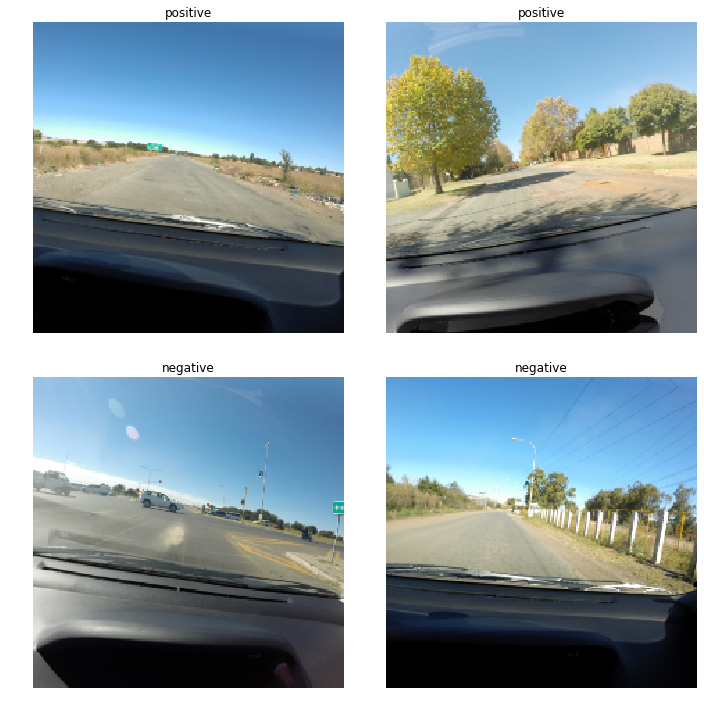

In [20]:
#Now let see what a our data set look like in a data batch
data.show_batch(rows=2, figsize=(10,10))

Looks perfect with the labels matching the image types

## Create and Run Model
As mentioned in the introduction bit, I will be using a pretrained model with Resnet34 architecture. Using a pretrained model means leveraging on the result(coeficents and intercepts) of the time and computational intensive training that has been done somewhere in the past and resulted in a converged model. So what is changing is only the last layer which needs to be customized to conform with the number of output activations required - in this case, 2.

In [23]:
#creat a pretrained model, this will download the pretrained weights
learn = cnn_learner(data, f_model, pretrained=True, metrics=accuracy)

#define the optimization function. Momentum which takes exponentially weighed averages of the gradients(making it less noisier than SGD) is an alternative
learn.opt_fn = optim.Adam

In [20]:
learn.summary()

Layer (type)         Output Shape         Param #    Trainable 
Conv2d               [64, 112, 112]       9,408      False     
______________________________________________________________________
BatchNorm2d          [64, 112, 112]       128        True      
______________________________________________________________________
ReLU                 [64, 112, 112]       0          False     
______________________________________________________________________
MaxPool2d            [64, 56, 56]         0          False     
______________________________________________________________________
Conv2d               [64, 56, 56]         36,864     False     
______________________________________________________________________
BatchNorm2d          [64, 56, 56]         128        True      
______________________________________________________________________
ReLU                 [64, 56, 56]         0          False     
______________________________________________________________

Finding a good learning rate. I will use the Fastai's `lr_find` method. How does it work? It takes the learner through one epoch starting with a very low `lr` like `e-5` and multiply this `lr` by a fact say `10` after every minibatch while recording the losses until the `lr` becomes very high say `100`. Ploting the `lr` vs loss, one can easily eye-ball and spot the best lr. See intuitive explanation [here](https://sgugger.github.io/how-do-you-find-a-good-learning-rate.html).
The chosen learning rate will be used as the max_lr in the 1cycle policy as in [here](https://docs.fast.ai/callbacks.one_cycle.html)

In [23]:
#finding a suitable learning rate.
#stop_div=False means dont stop at the points of divergence, because we want to see the behaviour of the curve beyond this point
#setting num_it=200 to an integer means this number of iteration will be run rather than a full epoch
#learn.lr_find(stop_div=False, num_it=200)
learn.lr_find() 

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


Min numerical gradient: 7.59E-03


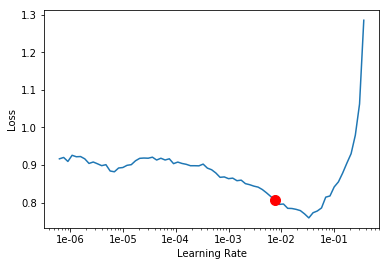

In [24]:
#get the lr vs losses plot
#learn.recorder.plot()
learn.recorder.plot(suggestion=True)

Looks like `3e-2` will be a good maximum learning rate here. I will now train the model using the `one_cycle_policy`and run 2 `epochs`.

In [24]:
max_lr = 3e-2

**Prior to this point, I was using google colab and everything was fine. But when I started training the model, I realised it was taking about an hour to complete one epoch. This was really ampering the sustained training required to have a converged model. Also, waiting patiently for hours to see the effect of the slightest tweak I made to the model was a no for me. That was the point I decided to move to GCP which reduced the training time by 90%.**

In [25]:
#run two epoch using the one cycle policy
fit_one_cycle(learn, 2, max_lr=max_lr)

epoch,train_loss,valid_loss,accuracy,time
0,0.624020,2.454063,0.675810,06:53
1,0.319369,0.184318,0.933915,06:53


Awesome! The model seems to be learning pretty quickly. I will unfreeze the model to the last two layers and see if there will be a significant improvement

In [41]:
learn.freeze_to(-2)
fit_one_cycle(learn, 2, max_lr=max_lr)

epoch,train_loss,valid_loss,accuracy,time
0,0.482084,0.735183,0.729426,07:22
1,0.310881,0.236488,0.907731,06:26


No significant improvement, not worth it. Now I will free the whole thing and see.

In [42]:
# had to re-run the cell that created the model and jump straight here to ensure a new learning is initiated
learn.unfreeze()
fit_one_cycle(learn, 2, max_lr=max_lr)

epoch,train_loss,valid_loss,accuracy,time
0,0.652622,4.380693,0.332918,06:22
1,0.548365,0.459754,0.789277,06:22


Totally worst off. I will stick with the fully frozen model, run 40 epochs and explore model interpretation.

In [25]:
fit_one_cycle(learn, 40, max_lr=max_lr)

epoch,train_loss,valid_loss,accuracy,time
0,0.442036,0.262185,0.905237,06:55
1,0.298957,0.198701,0.921446,06:52
2,0.256821,0.225023,0.918953,06:49
3,0.256384,0.524027,0.822943,06:51
4,0.255922,0.268126,0.910224,06:47
5,0.302645,0.365840,0.896509,06:48
6,0.269947,0.385568,0.857855,06:48
7,0.282413,0.480212,0.850374,06:49
8,0.328098,0.318683,0.851621,06:48
9,0.324112,0.345351,0.859102,06:45


## Training/Validation Losses and Learning rate 

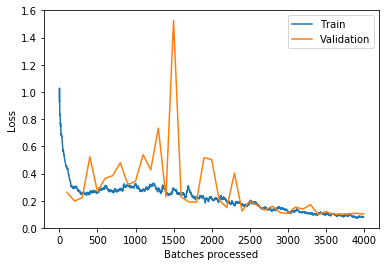

In [27]:
learn.recorder.plot_losses()

The model seemed to get settled after around 2500 batches

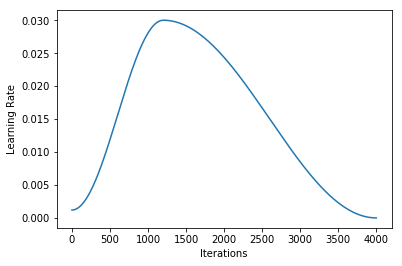

In [28]:
learn.recorder.plot_lr()

What I passed to the model at the beging of the epochs was the maximum learning rate, this plot shows all the LR used through the one-cycle policy in all the 40 epochs and 4000 iterations the model processed.

## Model interpretation
Since we now have a stable model, it's time to see how the model performing with detecting potholes and road surface irregularities. I will be using the interpretation class in fastai and it amazing methods.

In [31]:
#First let's get the prediction probabilities, outcome classes and the losses
preds,y,losses = learn.get_preds(with_loss=True)

#obtain interpretation as an object
interp = ClassificationInterpretation(learn, preds, y, losses)

### Confusion Matrix

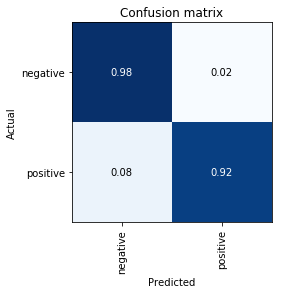

In [31]:
interp.plot_confusion_matrix(learn)

### Ground Truth and Predictions

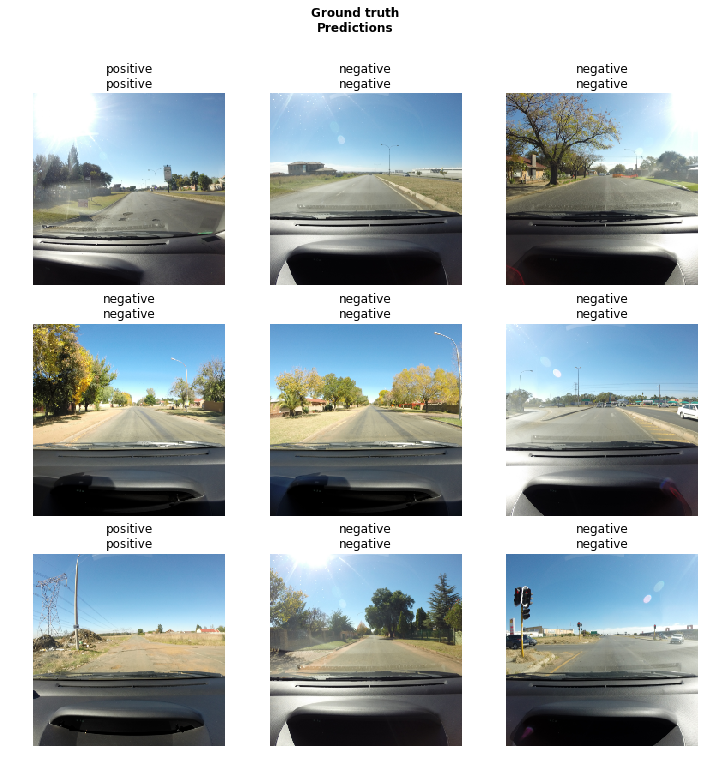

In [26]:
learn.show_results(rows=3)

As can be seen, the model has done a pretty good job. Look at how it even captured that little rough surface close to the dashboard in the last image at (3, 3).

### Top Losses

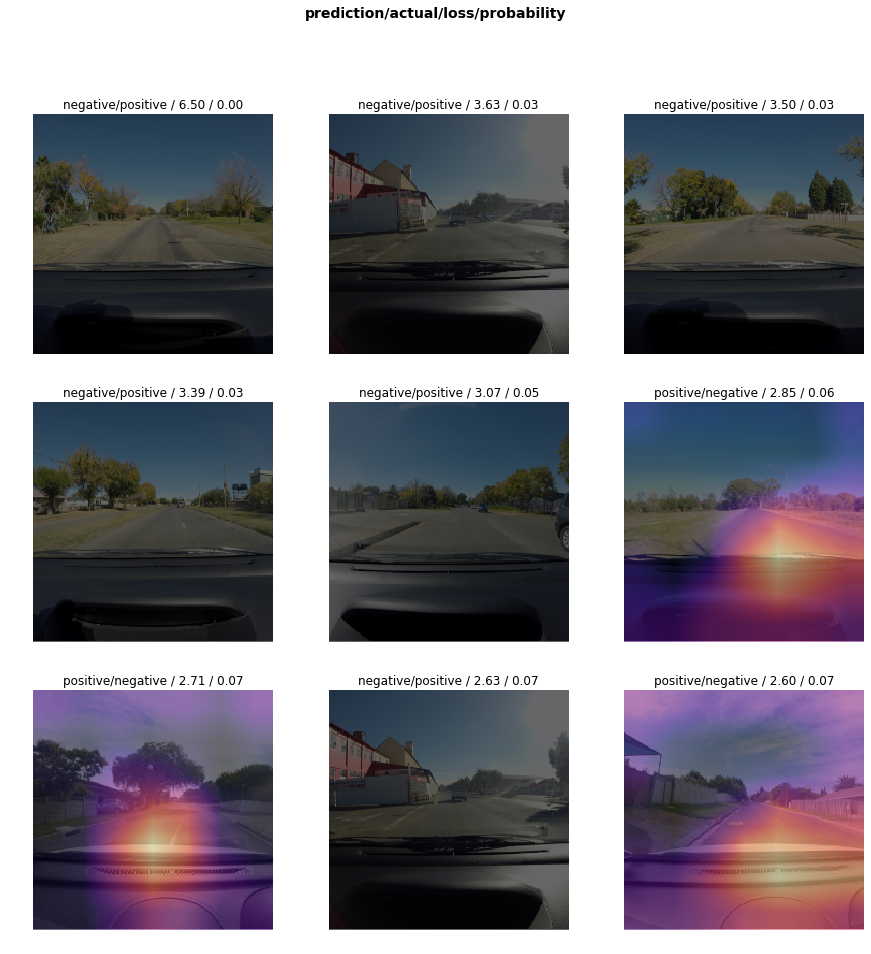

In [30]:
#visualize the 9 top losses
interp.plot_top_losses(9, figsize=(15,15))

Above list are the top misclassified images by the model, they have the highest loses. **But did the model actually commit all these errors?** <br>
<br>
Looking at the images, it's obvious that the model made the right descision in each case, even in the first image (1, 1) where it should have been confused by the shaddow of the street light and interprete it as pothole (like most human road users would). In the second image (1, 2), there's something that looks like a rough surface but it's actually not on the main road area, so the model still made the right call. <br>

These are all cases of mislabelling in the data and not errors from the model. In essence, the model performance could be way better than the printed out metrics below.


Here is the training report wrapped in a DataFrame

In [39]:
#train report in dataframe
train_report_df = pd.read_csv(PATH/'learner_record_40_epochs.csv')
train_report_df.head()

,epoch,train loss,valid loss,accuracy,time
0,0,0.507260,0.319302,0.859102,06:34
1,1,0.296829,0.296803,0.889027,06:47
2,2,0.272860,0.211223,0.917706,06:48
3,3,0.256902,0.225130,0.907731,06:42
4,4,0.282154,0.332068,0.899002,06:44


# Testing model with the testset
I will be testing with 100 images, 50 each from both classes. I will further process the initially obtaine `test_anno_df` as I did with the training set. 
The positve and negative test image files have been comined in a seperate file `simple_tst`, this is the file I will point the model to during testing.I will then load the model with this data.

In [29]:
unzip(PATH/'test_50_positive.zip', PATH/'test_50_positive')
unzip(PATH/'test_50_positive.zip', PATH/'test_50_merged')

In [30]:
unzip(PATH/'test_50_negative.zip', PATH/'test_50_negative')
unzip(PATH/'test_50_negative.zip', PATH/'test_50_merged')

In [31]:
#obtain labels from the folders
test_label = ['positive' for path in (PATH/'test_50_positive').iterdir()] + ['negative' for path in (PATH/'test_50_negative').iterdir()]
test_img_fn = [str(p)[-12:] for p in (PATH/'test_50_positive').iterdir()] + [str(p)[-12:] for p in (PATH/'test_50_negative').iterdir()]

test_data_class_df = pd.DataFrame({'test_fn':test_img_fn, 'test_label':test_label})
test_data_class_df.head()

,test_fn,test_label
0,G0032221.JPG,positive
1,G0031945.JPG,positive
2,G0041758.JPG,positive
3,G0032336.JPG,positive
4,G0031402.JPG,positive


In [32]:
#(PATH/'temp_classifier_csv').mkdir(exist_ok=True)
CSV_test = PATH/'temp_classifier_csv/lrg_test.csv'

test_data_class_df.to_csv(CSV_test, index=False)

The step in the two immidiate cells cell are not needed, I'm adding them so I will be able to display a batch of the test set just for visibility.

In [38]:
learner_test_data = (ImageDataBunch.from_csv(PATH, ds_tfms=tfms, size=224, csv_labels='temp_classifier_csv/lrg_test.csv', folder='test_50_merged', bs=16)
                     .normalize(imagenet_stats))

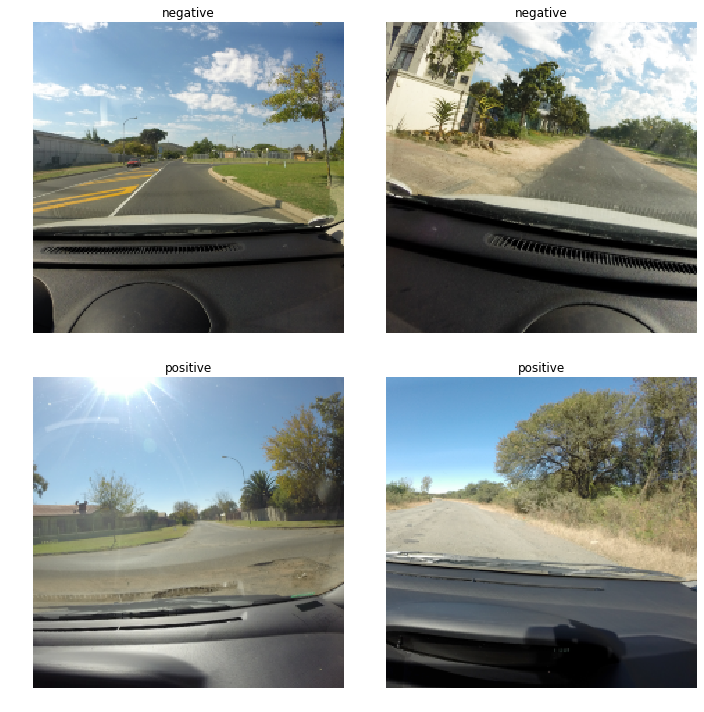

In [39]:
learner_test_data.show_batch(rows=2, figsize=(10,10))

Creating a DataBunch off the test set using the same parameters as the training set but with a lower batch size ( as we now have a smaller number of images)

In [45]:
learner_test = (ImageDataBunch.from_csv(PATH, bs=4, size=224, ds_tfms=tfms, csv_labels='temp_classifier_csv/lrg_test.csv', folder='test_50_merged')
                    .normalize(imagenet_stats))

loss, acc = learn.validate(learner_test.valid_dl)

In [46]:
print('Test loss is {} '.format(loss), '\n'); print('Test accuracy is {} '.format(acc), '\n')

Test loss is 0.023430053144693375  

Test accuracy is 1.0  



Awesome! It got all the instances perfectly correct. The average loss is quite low as well. Now I will download some random pothle images from Google and further test the model with them.

### Testing with some Random Google Images 

In [43]:
#use the download images in fastai lib to download the images from the urls
download_images(PATH/'potholes_google.txt', PATH/'test_images_google', max_pics=1000, max_workers=0)

Error https://whatsupibadan.com/wp-content/uploads/2017/07/bad-road.jpg HTTPSConnectionPool(host='whatsupibadan.com', port=443): Max retries exceeded with url: /wp-content/uploads/2017/07/bad-road.jpg (Caused by NewConnectionError('<urllib3.connection.VerifiedHTTPSConnection object at 0x7ff24c47ff28>: Failed to establish a new connection: [Errno -3] Temporary failure in name resolution'))


In [63]:
#collect the file names
test_google_fns = [str(p)[-12:] for p in (PATH/'test_images_google').iterdir()]
test_google_fns.remove('_checkpoints')

#create label
test_google_label = ['positive' for p in test_google_fns]

test_google_csv = pd.DataFrame({'test_google_fns':test_google_fns, 'test_google_label':test_google_label})
test_google_csv.head()

,test_google_fns,test_google_label
0,00000007.jpg,positive
1,00000001.JPG,positive
2,00000009.jpg,positive
3,00000017.jpg,positive
4,00000005.JPG,positive


In [64]:
#create CSV file off the files names and labels
CSV_test_google = PATH/'temp_classifier_csv/lrg_test_google.csv'

test_google_csv.to_csv(CSV_test_google, index=False)

In [65]:
data_test_google = (ImageDataBunch.from_csv(PATH, ds_tfms=tfms, size=224, csv_labels='temp_classifier_csv/lrg_test_google.csv', folder='test_images_google', bs=4)
                    .normalize(imagenet_stats))
                

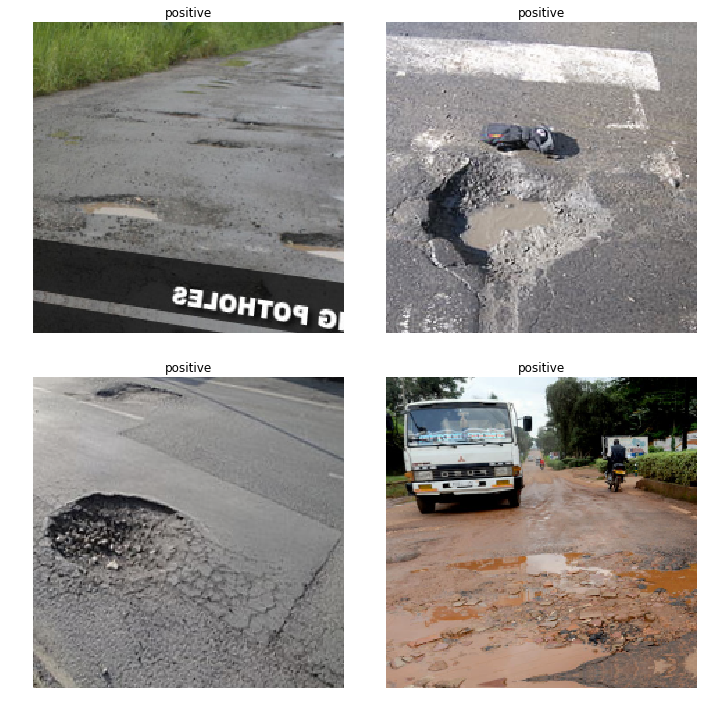

In [52]:
data_test_google.show_batch(rows=2, figsize=(10,10))

In [68]:
data_test_google = (ImageDataBunch.from_csv(PATH, bs=4, size=224, ds_tfms=tfms, csv_labels='temp_classifier_csv/lrg_test_google.csv', folder='test_images_google')
                    .normalize(imagenet_stats))
                
loss_google, acc_google = learn.validate(data_test_google.valid_dl)

In [70]:
print('Googles images Test loss is {} '.format(loss_google), '\n'); print('Google images test accuracy is {} '.format(acc_google), '\n')

Googles images Test loss is 0.04869984835386276  

Google images test accuracy is 1.0  



# Puting this model to use

Now that everything is set and the model is working as expected, I will export it for **inference.** With the `export` method as below everything needed to put the model to production including the gradients, intercepts, tranformations, labels, dependencies, normalization used are saved into to a pikle file which is then exported a the stipulated directory. To deploy this model on a server or a different machine, this will be the only file needed to be copied. 

In [77]:
#my observation with this method is that it assumes the notebook is running from the folder where the data is 
#located(which is not true, in this case), so including PATH(i.e 'pothole_detection_data/simplex_set') 
#will create repeated file paths
learn.export('pothole_final_model/export.pkl')

**Note:** Runing the export cell above authomatically created another folder called `models` which had a `.pth` file in it. I had to manually move the `.pkl` file from `pothole_final_model` into the `models` before being able to load.

# Inference
Here is a guide on how this model (the exported pikle file) could be loaded and used in a production environment - either on a server or CPU.

**Step 1:** Import the image(s) you want to classify. For this demonstration I will be using 2 images from the complex dataset (I did not use the complex set at all while building the model). This will be something like uploading an image into a web application. It could also be frames from video feeds from a multitude of CCTV to capture road conditions arround a City or even a State.

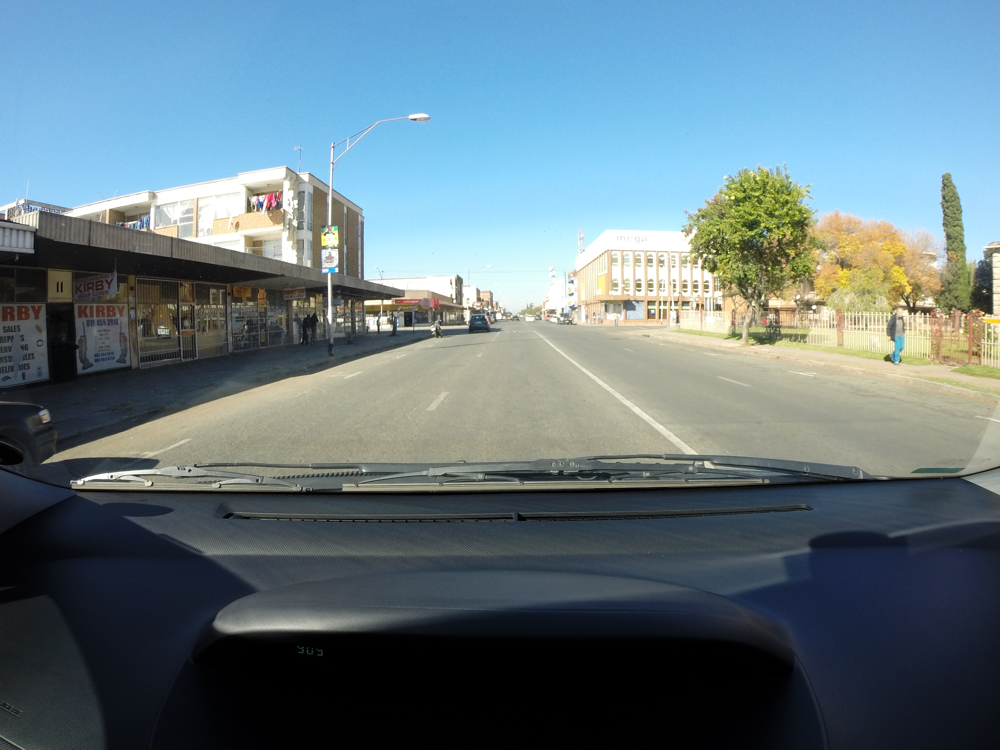

In [98]:
img0  = open_image(PATH/'img0.JPG')
img0

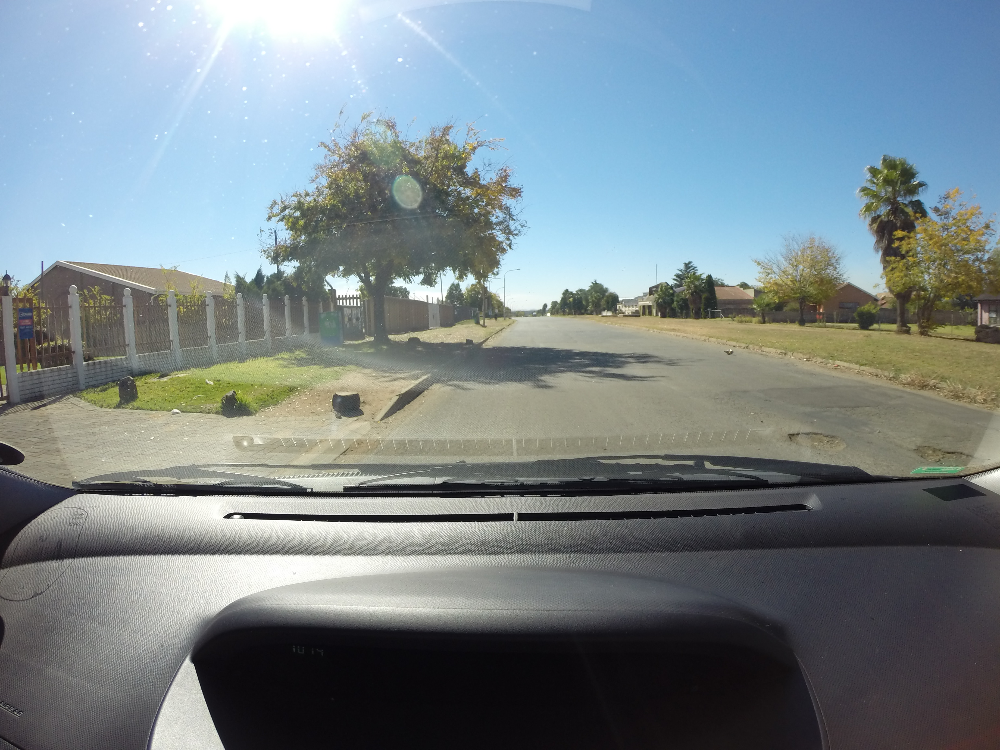

In [5]:
img1  = open_image(PATH/'img1.JPG')
img1

**Step 2:** The application will create a DataBunch as per how the model was built (using similar transformation, normailization, size and et al) but this time around with just a single image uploaded by the user.

In [84]:
classes = data.classes

In [91]:
learner_test_inf1 = ImageDataBunch.single_from_classes(PATH, classes, size=224, ds_tfms=tfms).normalize(imagenet_stats)

Here I'm not passing in any data, this is just to replicate the data structure used in building the model while calling it. The path stipulated is the path to the exported pickle file representing the model.

**Step 3:** Load the model

In [95]:
learn = cnn_learner(learner_test_inf1, models.resnet34)
learn.load('models')

Learner(data=ImageDataBunch;

Train: LabelList (0 items)
x: ImageList

y: CategoryList

Path: pothole_detection_data/simplex_set;

Valid: LabelList (0 items)
x: ImageList

y: CategoryList

Path: pothole_detection_data/simplex_set;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_run

Now the model has been loaded along with all its attributes and ready to be used

**Step 4:** load the uploaded image and make prediction. In our example I will start with the first image (negative).

In [99]:
pred_class, pred_idx, output = learn.predict(img0)
pred_class, pred_idx, output

(Category negative, tensor(0), tensor([0.6998, 0.3002]))

In [101]:
pred_class, pred_idx, output = learn.predict(img1)
pred_class, pred_idx, output

(Category positive, tensor(1), tensor([0.3080, 0.6920]))

**Wow! the model correctly predicted both images as `negative` and `positive` resectively. Even the probability for the correct class in both cases is 70% which is quite impressive.**

# Conclusion and Areas of Further Improvement
I had set out not to only create a classifier but to also include a regression model that will capture the location of the potholes by drawing bounding box arround them. I have the data and the annotations file put together and have the data generator created alredy . But I had memory issues with my CGP VP. I found a number of work arround for this online as it has to do  with Fastai's backed library (pytorch). I will be exploring those options going forward to complete the bounding box model. I will be updating this notebook from time to time.